In [ ]:
import os
import librosa
import pandas as pd
import random
import numpy as np
import matplotlib.pyplot as plt
import pyroomacoustics as pra
from IPython.display import Audio

In [ ]:
source_path = "/media/zanub/39768EEB549F8712/projects/seld-net/datasets/ANSIM/ov1_split1/desc_ov1_split1"

sum = 0
lowest = 100000
biggest = 0

for i in os.listdir(source_path):
    file_path = os.path.join(source_path, i)
    df = pd.read_csv(file_path, usecols=['start_time', 'end_time'])

    if df.shape[0] < lowest:
        lowest = df.shape[0]

    if df.shape[0] > biggest:
        biggest = df.shape[0]

print(random.sample(os.listdir(source_path), 3))

['train_239_desc_30_100.csv', 'test_43_desc_30_100.csv', 'train_17_desc_30_100.csv']


In [302]:
y, sr = librosa.load("/media/zanub/39768EEB549F8712/projects/SELD-quadcopter/dataset_generator/sounds/whistles/[_0SMVzXhf-s]_whistle_sound_1.wav", sr=44100, mono=False)
y.shape[-1]

38912

In [ ]:
np.random.uniform(1, 2)

1.0638870056170582

In [299]:
max(0, np.random.normal(1.5, 100))

144.59644537274275

In [6]:
whistles_directory = "./sounds/whistles"
motor_noise_directory = "./sounds/augmented_drone_motor_noises"
seconds_length = 30
sr = 44100
snr_db = 3

seconds_elapsed = 0
sound_event_gap = 1.5
sound_event_gap_tolerant = 0.2

def normalize_sound(sound):
    sound_normalized = np.zeros(sound.shape)
    for i, y in enumerate(sound):
        sound_normalized[i] = y / np.max(np.abs(sound))
    return sound_normalized

def get_random_3d_pos(radius_outside=50, radius_inside=25):
    while True:
        r = radius_outside * np.cbrt(np.random.rand())  # Uniform in volume
        if r >= radius_inside:
            break

    theta = np.arccos(2 * np.random.rand() - 1)  # Polar angle (0 to pi)
    phi = 2 * np.pi * np.random.rand()  # Azimuthal angle (0 to 2pi)

    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta)

    return np.array([x, y, z])

whistle_file_names = os.listdir(whistles_directory)
whistles_paths = [os.path.join(whistles_directory, f) for f in whistle_file_names]

motor_noise_file_names = os.listdir(motor_noise_directory)
motor_noise_paths = [os.path.join(motor_noise_directory, f) for f in motor_noise_file_names]

room = pra.AnechoicRoom(fs=sr, air_absorption=True)

mic_positions = np.array([
    [ 0.0420,  0.0615, -0.0410],
    [-0.0420,  0.0615,  0.0410],
    [-0.0615,  0.0420, -0.0410],
    [-0.0615, -0.0420,  0.0410],
    [-0.0420, -0.0615, -0.0410],
    [ 0.0420, -0.0615,  0.0410],
    [ 0.0615, -0.0420, -0.0410],
    [ 0.0615,  0.0420,  0.0410],
    ]).T  # Position of microphone
room.add_microphone_array(mic_positions)

while True:
    whistle_path = np.random.choice(whistles_paths)
    motor_noise_signal, sr = librosa.load(whistle_path, mono=False, sr=sr)
    sound_length = motor_noise_signal.shape[-1] / sr
    random_gap = max(0, np.random.normal(sound_event_gap, sound_event_gap_tolerant))
    if seconds_elapsed + random_gap + sound_length >= seconds_length:
        break
    seconds_elapsed += random_gap
    source_position = get_random_3d_pos()
    room.add_source(source_position, signal=motor_noise_signal, delay=seconds_elapsed)
    seconds_elapsed += sound_length

room.compute_rir()
room.simulate()

whistle_signals = room.mic_array.signals
whistle_signals_norm = normalize_sound(whistle_signals)

for i in motor_noise_paths:
    motor_noise_signal, sr = librosa.load(i, mono=False, sr=sr)

    length_difference = np.abs(motor_noise_signal.shape[1] - whistle_signals_norm.shape[1])
    whistle_signals_norm = np.pad(
        whistle_signals_norm,
        ((0,0), (0, (length_difference))),
        mode='constant',
        constant_values=0
    )

    desired_noise_power = np.linalg.norm(whistle_signals_norm) / snr_db
    motor_noise_signal = desired_noise_power / np.linalg.norm(motor_noise_signal)

    microphone_signals = whistle_signals_norm + motor_noise_signal
    microphone_signals = normalize_sound(microphone_signals)
    break


def simulate_whistle_signals(room):
    seconds_elapsed = 0

    whistle_metadata = []

    while True:
        whistle_file_name = np.random.choice(whistle_file_names)
        whistle_file_path = os.path.join(whistles_directory, whistle_file_name)
        whistle_signal, _ = librosa.load(whistle_file_path, mono=False, sr=sr)

        signal_length = np.ceil(whistle_signal.shape[-1] / sr)
        random_gap = max(0, np.random.normal(sound_event_gap, sound_event_gap_tolerant))
        if seconds_elapsed + random_gap + signal_length >= seconds_length:
            break
        seconds_elapsed += random_gap

        x, y, z = get_random_3d_pos()
        room.add_source([x, y, z], signal=whistle_signal, delay=seconds_elapsed)
        whistle_metadata.append(
            {
                'sound_event_recording': whistle_file_name,
                'start_time': seconds_elapsed,
                'end_time': seconds_elapsed + signal_length,
                'ele': np.arctan2(z, np.sqrt(x**2 + y**2)),
                'azi': np.arctan2(y, x),
                'distance': np.sqrt(x**2 + y**2 + z**2)
            }
        )

        seconds_elapsed += signal_length
    
    room.compute_rir()
    room.simulate()
    return room, whistle_metadata


# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
# room.plot(ax=ax)
# ax.set_xlim([-100, 100])
# ax.set_ylim([-100, 100])
# ax.set_zlim([-100, 100])
# plt.show()

# sf.write(('./test.wav'), sound_signals.T, sr, subtype='DOUBLE')

# sound_signals = room.mic_array.signals
# sound_signals_norm = normalize_sound(sound_signals)
# sd.play(sound_signals_norm.T, samplerate=sr) # here
# sd.wait()

Audio(microphone_signals, rate=sr)

In [15]:
pd.DataFrame(microphone_signals.T)

,0,1,2,3,4,5,6,7
0,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
1,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
2,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
3,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
4,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
...,...,...,...,...,...,...,...,...
1448676,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
1448677,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
1448678,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412
1448679,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412,0.226412


In [54]:
test = []

test.append(0)
test.append(1)
test.append(2)
test.append([3, 9])
test.append(4)
test.append(5)
test.append(np.array([[5, 6, 7, 8], [9, 10, 11, 12]]))
test.append(7)

In [55]:
type(test[6])

numpy.ndarray

In [56]:
print(np.max(test[6]))

12


In [11]:
room = pra.AnechoicRoom(fs=44100, air_absorption=True)
mic_positions = np.array([
    [ 0.0420,  0.0615, -0.0410],
    [-0.0420,  0.0615,  0.0410],
    [-0.0615,  0.0420, -0.0410],
    [-0.0615, -0.0420,  0.0410],
    [-0.0420, -0.0615, -0.0410],
    [ 0.0420, -0.0615,  0.0410],
    [ 0.0615, -0.0420, -0.0410],
    [ 0.0615,  0.0420,  0.0410],
    ]).T  # Position of microphone
room.add_microphone_array(mic_positions)

# dir(room.mic_array)
help(room.mic_array)

Help on MicrophoneArray in module pyroomacoustics.beamforming object:

class MicrophoneArray(builtins.object)
 |  MicrophoneArray(R, fs, directivity=None)
 |
 |  Microphone array class.
 |
 |  Methods defined here:
 |
 |  __init__(self, R, fs, directivity=None)
 |      Initialize self.  See help(type(self)) for accurate signature.
 |
 |  __len__(self)
 |
 |  append(self, locs)
 |      Add some microphones to the array.
 |
 |      Parameters
 |      ----------
 |      locs: numpy.ndarray (2 or 3, n_mics)
 |          Adds `n_mics` microphones to the array. The coordinates are passed as
 |          a `numpy.ndarray` with each column containing the coordinates of a
 |          microphone.
 |
 |  record(self, signals, fs)
 |      This simulates the recording of the signals by the microphones.
 |      In particular, if the microphones and the room simulation
 |      do not use the same sampling frequency, down/up-sampling
 |      is done here.
 |      Parameters
 |      ----------
 |      si

In [ ]:
whistles_directory = "./sounds/whistles"
motor_noise_directory = "./sounds/augmented_drone_motor_noises"
wav_result_directory = "./sounds/8_channel_microphone_signals/description"
description_result_directory = "./sounds/8_channel_microphone_signals/wav"
seconds_length = 30
sr = 44100
snr_db = -5

max_possible_whistle_radius = 100
min_possible_whistle_radius = 50

sound_event_gap = 1.5
sound_event_gap_tolerant = 0.2

mic_positions = np.array([
    [ 0.0420,  0.0615, -0.0410],
    [-0.0420,  0.0615,  0.0410],
    [-0.0615,  0.0420, -0.0410],
    [-0.0615, -0.0420,  0.0410],
    [-0.0420, -0.0615, -0.0410],
    [ 0.0420, -0.0615,  0.0410],
    [ 0.0615, -0.0420, -0.0410],
    [ 0.0615,  0.0420,  0.0410],
    ]).T


whistle_file_names = os.listdir(whistles_directory)
whistles_paths = [os.path.join(whistles_directory, f) for f in whistle_file_names]

motor_noise_file_names = os.listdir(motor_noise_directory)
motor_noise_paths = [os.path.join(motor_noise_directory, f) for f in motor_noise_file_names]




def get_random_3d_pos(max_radius=max_possible_whistle_radius, min_radius=min_possible_whistle_radius):
    while True:
        r = max_radius * np.cbrt(np.random.rand())  # Uniform in volume
        if r >= min_radius:
            break

    theta = np.arccos(2 * np.random.rand() - 1)  # Polar angle (0 to pi)
    phi = 2 * np.pi * np.random.rand()  # Azimuthal angle (0 to 2pi)

    x = r * np.sin(theta) * np.cos(phi)
    y = r * np.sin(theta) * np.sin(phi)
    z = r * np.cos(theta)

    return x, y, z

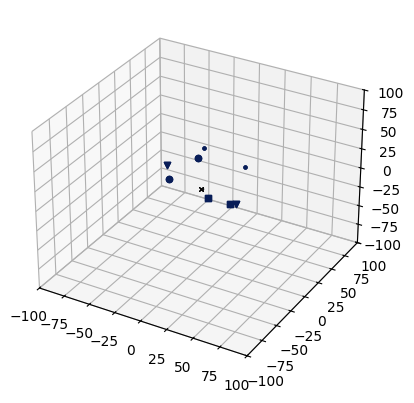

In [15]:
room = pra.AnechoicRoom(fs=44100, air_absorption=True)

mic_positions = np.array([
    [ 0.0420,  0.0615, -0.0410],
    [-0.0420,  0.0615,  0.0410],
    [-0.0615,  0.0420, -0.0410],
    [-0.0615, -0.0420,  0.0410],
    [-0.0420, -0.0615, -0.0410],
    [ 0.0420, -0.0615,  0.0410],
    [ 0.0615, -0.0420, -0.0410],
    [ 0.0615,  0.0420,  0.0410],
    ]).T  # Position of microphone

room.add_microphone_array(mic_positions)
room, whistle_metadata = simulate_whistle_signals(room)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')
room.plot(ax=ax)
ax.set_xlim([-100, 100])
ax.set_ylim([-100, 100])
ax.set_zlim([-100, 100])
plt.show()

In [26]:
whistle_metadata[0]['sound_event_recording']

np.str_('[RF2OUtj445s]_whistle_sound_38.wav')